<a href="https://colab.research.google.com/github/nilaycicekli/internship/blob/main/explain_yolov5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# setup
Clone repo, install dependencies and check PyTorch and GPU.

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt  # install dependencies

import torch
from IPython.display import Image, clear_output  # to display images

clear_output()
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Setup complete. Using torch 1.8.1+cu101 (Tesla P4)


# 1. Inference

`detect.py` runs YOLOv5 inference on a variety of sources, downloading models automatically from the [latest YOLOv5 release](https://github.com/ultralytics/yolov5/releases), and saving results to `runs/detect`. Example inference sources are:

<img src="https://user-images.githubusercontent.com/26833433/114307955-5c7e4e80-9ae2-11eb-9f50-a90e39bee53f.png" width="900"> 

In [ ]:
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights yolov5s.pt --img 640 --conf 0.25 --source ../test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.25, device='', exist_ok=False, hide_conf=False, hide_labels=False, img_size=640, iou_thres=0.45, line_thickness=3, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='../test/images', update=False, view_img=False, weights=['yolov5s.pt'])
YOLOv5 🚀 v5.0-68-gb18ca31 torch 1.8.1+cu101 CUDA:0 (Tesla P4, 7611.9375MB)

100% 14.1M/14.1M [00:00<00:00, 47.5MB/s]

Fusing layers... 
Model Summary: 224 layers, 7266973 parameters, 0 gradients
image 1/63 /content/yolov5/../test/images/00dea1edf14f09ab_jpg.rf.e88c0cbf2d2fa49acf7710d4962b3835.jpg: 640x640 1 person, 1 truck, Done. (0.032s)
image 2/63 /content/yolov5/../test/images/00e481ea1a520175_jpg.rf.49a7562e0ada29cc96e9da3321c96b70.jpg: 640x640 3 buss, Done. (0.023s)
image 3/63 /content/yolov5/../test/images/08c8b73e0c2e296e_jpg.rf.24496f1095ffd45262fd1f9d9865e94a.jpg: 640x640 6 persons, 1 bicycle, 1 car, 3 

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.25, device='', exist_ok=False, hide_conf=False, hide_labels=False, img_size=640, iou_thres=0.45, line_thickness=3, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='data/images/', update=False, view_img=False, weights=['yolov5s.pt'])
YOLOv5 🚀 v5.0-42-g4200674 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

100% 14.1M/14.1M [00:00<00:00, 49.7MB/s]

Fusing layers... 
Model Summary: 224 layers, 7266973 parameters, 0 gradients, 17.0 GFLOPS
image 1/2 /content/yolov5/data/images/bus.jpg: 640x480 4 persons, 1 bus, 1 fire hydrant, Done. (0.028s)
image 2/2 /content/yolov5/data/images/zidane.jpg: 384x640 2 persons, 2 ties, Done. (0.010s)
Results saved to runs/detect/exp
Done. (0.162s)


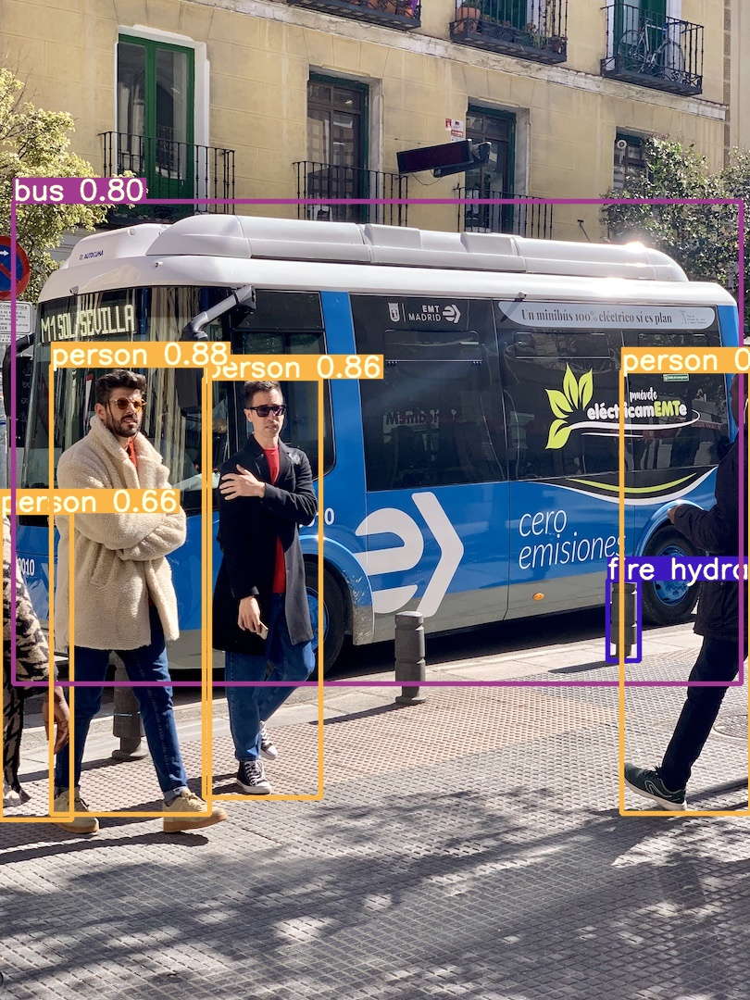

In [ ]:
!python detect.py --weights yolov5s.pt --img 640 --conf 0.25 --source data/images/
Image(filename='runs/detect/exp/bus.jpg', width=600)

# 2. Test
Test a model's accuracy on [COCO](https://cocodataset.org/#home) val or test-dev datasets. Models are downloaded automatically from the [latest YOLOv5 release](https://github.com/ultralytics/yolov5/releases). To show results by class use the `--verbose` flag. Note that `pycocotools` metrics may be ~1% better than the equivalent repo metrics, as is visible below, due to slight differences in mAP computation.

# 3. Train
with custom dataset

## Download custom dataset

In [ ]:
%cd /content
!curl -L "https://public.roboflow.com/ds/ytT2TDWlsy?key=2s01cLb530" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1148      0 --:--:-- --:--:-- --:--:--  1147
100 19.1M  100 19.1M    0     0  17.1M      0  0:00:01  0:00:01 --:--:--  275M
Archive:  roboflow.zip
 extracting: test/images/e4029e591e9568b4_jpg.rf.38b756a0f97631981546c972c9ecd9a1.jpg  
 extracting: test/images/95bf6406c152cf40_jpg.rf.3834c6a0d56619c964611f5667f6e393.jpg  
 extracting: test/images/08c8b73e0c2e296e_jpg.rf.24496f1095ffd45262fd1f9d9865e94a.jpg  
 extracting: test/images/d66aabbb1f7299cc_jpg.rf.38b5dfbdf7b988873455d0caae38105d.jpg  
 extracting: test/images/cf165ec304d2b2dc_jpg.rf.26a644096c9f7c14dc93e7d87f9e974c.jpg  
 extracting: test/images/c094d0187caf81e3_jpg.rf.2cabd8d84aadded75295d97a9f462aad.jpg  
 extracting: test/images/a3cffcdbff959432_jpg.rf.3670bb831774cd754bf13150ae24ebe3.jpg  
 extracting: test/images/778f80f86cd

In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 5
names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']

## Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [ ]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [ ]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

## Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights.
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [ ]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 100 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights 'yolov5s.pt' --name yolov5s_results  --cache

/content/yolov5
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-42-g4200674 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, artifact_alias='latest', batch_size=16, bbox_interval=-1, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='../data.yaml', device='', entity=None, epochs=100, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5s_results', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=16, upload_dataset=False, weights='yolov5s.pt', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
2021-04-28 08:02:03.717387: I tensorflow/stream_execu

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

## visualize the training data

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cp /content/yolov5/runs/train/yolov5s_results/weights/best.pt /content/gdrive/My\ Drive

In [ ]:
#from google.colab import files
#files.download('/content/yolov5/runs/train/yolov5s_results/weights/best.pt')

In [ ]:
# first, display the ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/test_batch0_labels.jpg', width=900)

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/train_batch0.jpg', width=900)

## run inference with trained weights

In [ ]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [ ]:
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../test/images

# display 

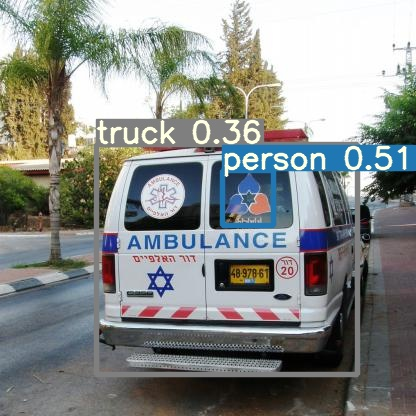

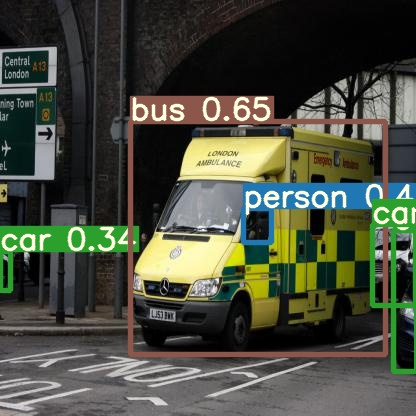

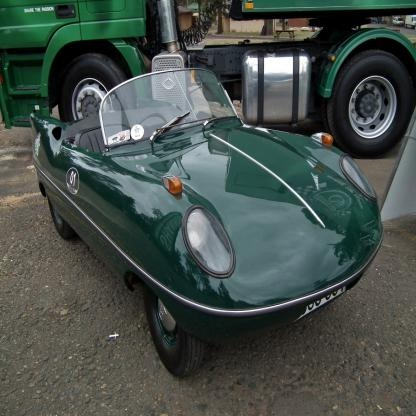

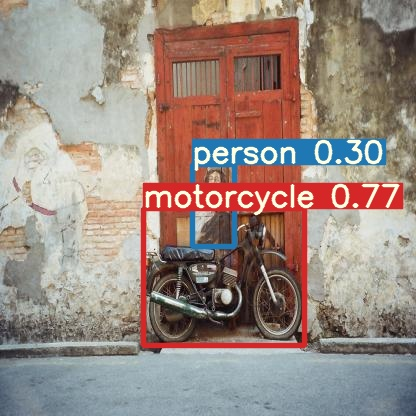

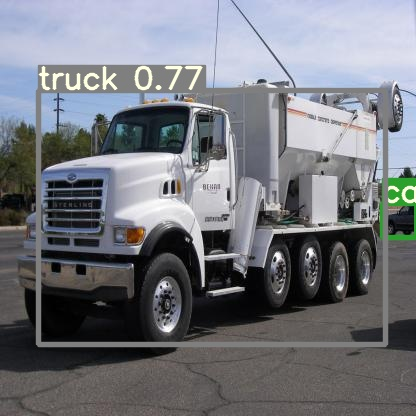

...

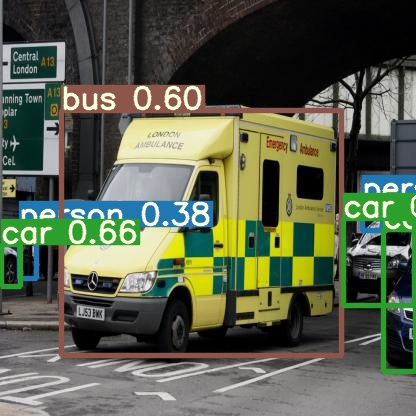

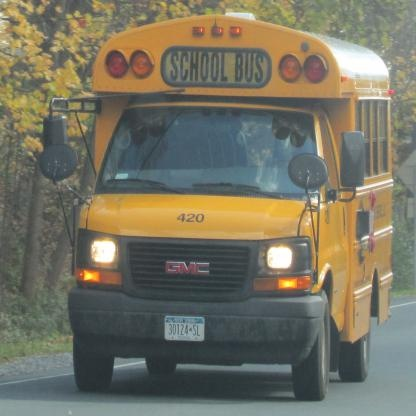

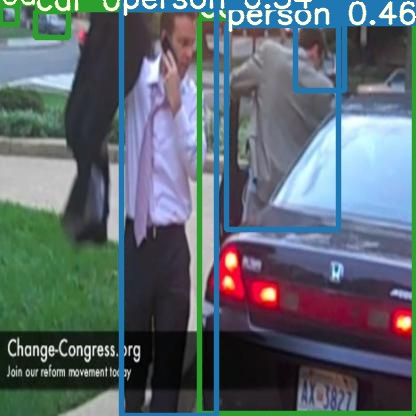

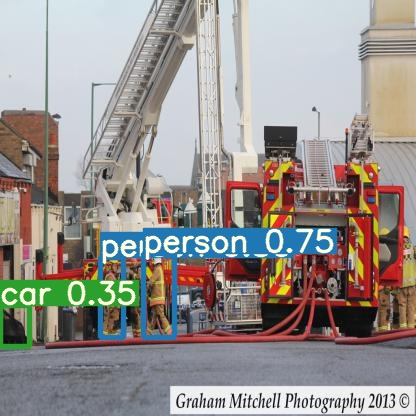

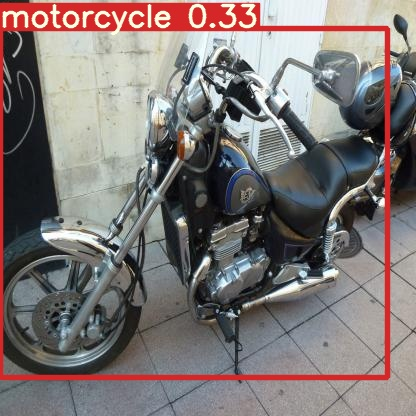

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob

from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
# PyTorch Hub
import torch

# Model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

# Images
#dir = 'https://github.com/ultralytics/yolov5/raw/master/data/images/'
imgs = '/content/test/images/00dea1edf14f09ab_jpg.rf.e88c0cbf2d2fa49acf7710d4962b3835.jpg'
#imgs = [dir + f for f in ('zidane.jpg', 'bus.jpg')]  # batch of images

# Inference
results = model(imgs)
results.print()  # or .show(), .save()

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master


Fusing layers... 


Model Summary: 224 layers, 7266973 parameters, 0 gradients
Adding autoShape... 
YOLOv5 🚀 2021-5-5 torch 1.8.1+cu101 CUDA:0 (Tesla P4, 7611.9375MB)



image 1/1: 416x416 1 person, 1 truck
Speed: 45.3ms pre-process, 70.5ms inference, 71.9ms NMS per image at shape (1, 3, 640, 640)


In [ ]:
# Model
model = torch.hub.load('ultralytics/yolov5','custom', path_or_model='runs/train/yolov5s_results/weights/best.pt')

In [ ]:
# PyTorch Hub
import torch

# Model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')


from PIL import Image
import glob
image_list = []
for filename in glob.glob('/content/test/images/*.jpg'): #assuming jpg
    im=Image.open(filename)
    image_list.append(im)

# Inference
results = model(image_list)
results.print()  # or .show(), .save()

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
Fusing layers... 
Model Summary: 224 layers, 7266973 parameters, 0 gradients
Adding autoShape... 
YOLOv5 🚀 2021-5-5 torch 1.8.1+cu101 CUDA:0 (Tesla P4, 7611.9375MB)



image 1/63: 416x416 1 person, 1 truck
image 2/63: 416x416 1 person, 3 cars, 1 bus
image 3/63: 416x416
image 4/63: 416x416 1 person, 1 motorcycle
image 5/63: 416x416 1 car, 1 truck
image 6/63: 416x416 3 cars
image 7/63: 416x416 5 persons, 6 motorcycles
image 8/63: 416x416 3 buss
image 9/63: 416x416 2 cars, 1 truck
image 10/63: 416x416 1 bicycle, 3 cars, 1 stop sign
image 11/63: 416x416 4 persons, 1 car, 2 buss
image 12/63: 416x416 3 cars
image 13/63: 416x416 1 truck
image 14/63: 416x416 8 cars, 1 traffic light
image 15/63: 416x416 1 car
image 16/63: 416x416 8 persons, 1 motorcycle
image 17/63: 416x416 2 persons
image 18/63: 416x416 1 car
image 19/63: 416x416 1 car, 1 bus
image 20/63: 416x416 1 truck
image 21/63: 416x416 1 car, 1 truck
image 22/63: 416x416 2 cars
image 23/63: 416x416 10 persons, 1 bicycle, 4 cars, 1 bus, 1 suitcase
image 24/63: 416x416 5 persons, 2 trucks, 1 umbrella, 1 chair
image 25/63: 416x416 1 person, 1 bus
image 26/63: 416x416 15 persons, 1 car
image 27/63: 416x416

# explain

# Explain

In [ ]:
!pip install shap

     |████████████████████████████████| 358kB 8.0MB/s 
  Created wheel for shap: filename=shap-0.39.0-cp37-cp37m-linux_x86_64.whl size=491623 sha256=7636828f4c20ee17c32e7e930251abb6a09288f76b56fb58ca404f6a5dd68c35
  Stored in directory: /root/.cache/pip/wheels/15/27/f5/a8ab9da52fd159aae6477b5ede6eaaec69fd130fa0fa59f283
Successfully built shap


In [ ]:
import shap

shap.initjs()

In [ ]:
import numpy as np

data = []
for filename in glob.glob('/content/train/images/*.jpg'): #assuming jpg
    im=Image.open(filename)
    data.append(np.asarray(im))
data = np.array(data)

In [ ]:
import cv2

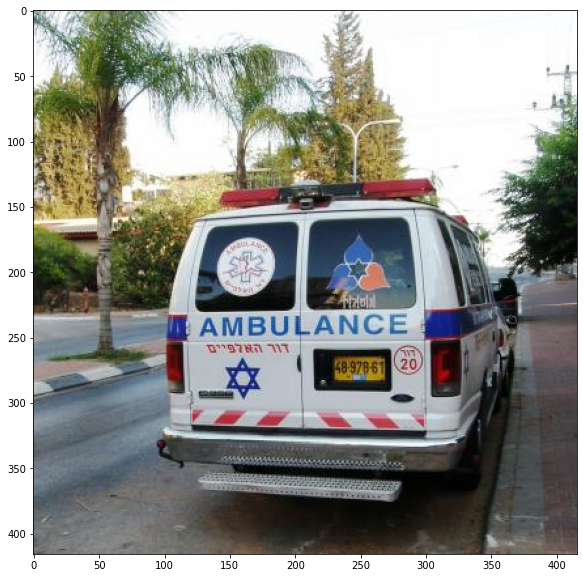

In [ ]:
import cv2
import matplotlib.pyplot as plt


img_org = cv2.imread("/content/test/images/00dea1edf14f09ab_jpg.rf.e88c0cbf2d2fa49acf7710d4962b3835.jpg", cv2.IMREAD_COLOR)
img_org = cv2.cvtColor(img_org, cv2.COLOR_BGR2RGB)
img = img_org.astype("float64")/255


plt.figure(figsize=(10, 10))
plt.imshow(img_org)
plt.show()

In [ ]:
# PyTorch Hub
import torch

# Model
# model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)
model = torch.hub.load('ultralytics/yolov5','custom',path='/content/yolov5s.pt')
detector = model.autoshape()

Downloading: "https://github.com/ultralytics/yolov5/archive/master.zip" to /root/.cache/torch/hub/master.zip


requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13

requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



Fusing layers... 


Model Summary: 224 layers, 7266973 parameters, 0 gradients
Adding autoShape... 
YOLOv5 🚀 2021-5-6 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)



autoShape already enabled, skipping... 


In [ ]:
model.model

Model(
  (model): Sequential(
    (0): Focus(
      (conv): Conv(
        (conv): Conv2d(12, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (act): SiLU(inplace=True)
      )
    )
    (1): Conv(
      (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (act): SiLU(inplace=True)
    )
    (2): C3(
      (cv1): Conv(
        (conv): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1))
        (act): SiLU(inplace=True)
      )
      (cv2): Conv(
        (conv): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1))
        (act): SiLU(inplace=True)
      )
      (cv3): Conv(
        (conv): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
        (act): SiLU(inplace=True)
      )
      (m): Sequential(
        (0): Bottleneck(
          (cv1): Conv(
            (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1))
            (act): SiLU(inplace=True)
          )
          (cv2): Conv(
            (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(

In [ ]:


class OD2Score(torch.nn.Module):
    def __init__(self):
        
        super(OD2Score, self).__init__()

    def forward(self, x):
        score_best_box = torch.zeros([len(x.xyxy),2], device='cuda:0')
        for idx, score in enumerate(x.xyxy):
          sum = 0
          if score.shape[0]:
            for i in range(score.shape[0]):
              sum+=x.xyxy[idx][i][4]
            sum = sum/score.shape[0]
          score_best_box[idx] = torch.tensor([sum])
  
        return score_best_box.cpu().numpy()

# look at the image output above and set the index of the object you want to analyze here
scoring = OD2Score()

class CastNumpy(torch.nn.Module):
  def __init__(self):
    super(CastNumpy, self).__init__()
  
  def forward(self, image):
    if len(image.shape) == 4:
      image = image.squeeze(0)
    return image

numpy2torch_converter = CastNumpy()

model = torch.nn.Sequential(
    numpy2torch_converter,
    model,
    scoring
)

exp_image = np.array(img_org)
exp_image = np.expand_dims(exp_image,axis=0)
kernel_explainer = shap.KernelExplainer(model,exp_image)

e = kernel_explainer.shap_values(np.array(img_org))

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master


requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...


Fusing layers... 



requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



Model Summary: 232 layers, 7257306 parameters, 0 gradients
Adding autoShape... 
YOLOv5 🚀 2021-5-5 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)



autoShape already enabled, skipping... 


AssertionError: ignored

In [ ]:
#pred func, background data
explainer = shap.KernelExplainer(model=pred, data=data)

Provided model function fails when applied to the provided data set.


ValueError: ignored

# yolo to tensorflow

In [ ]:
import os
import tensorflow as tf
from tensorflow.python.saved_model import builder as saved_model_builder
from darkflow.net.build import TFNet

options = {"model": "yolov2-tiny.cfg", "load": "yolov2-tiny.weights", "threshold": 0.1}

tfnet = TFNet(options)

export_path = "./export/1/"

tfnet.build_model(export_path = export_path)

with tfnet.sess.graph.as_default():
    prediction_signature = tf.saved_model.signature_def_utils.build_signature_def(
        inputs={
            "input": tf.saved_model.utils.build_tensor_info(x)
        },
        outputs={
            "output": tf.saved_model.utils.build_tensor_info(pred)
        },
        method_name=tf.saved_model.signature_constants.PREDICT_METHOD_NAME
    )
    builder = saved_model_builder.SavedModelBuilder(export_path)
    builder.add_meta_graph_and_variables(
        tfnet.sess, [tf.saved_model.tag_constants.SERVING],
        signature_def_map={
            "predict": prediction_signature,
        })

    builder.save()